# Shadow Extraction Algorithm

This notebook shows how to extract tank shadows from RGB images and use them to estimate the volume of floating head tanks.

The algorithm uses a bounding box to crop a single tank from a larger image. The tank shadow features are then enhanced using a transformation with HSV and LAB color space. The enhanced image is thresholded, creating a mask. The mask is processed with morphological operations to isolate the regions belonging to the tank shadows. Volume is estimated via the ratio of the smaller tank shadow to the larger tank shadow.

## Read in Packages

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import sys
import os
import json
import geopandas as gpd
import numpy as np

import cv2
from skimage import data, filters, exposure, measure, segmentation, morphology, color
#import torch
import fastai
#rasterio.__version__
#from PIL import Image
import matplotlib as mpl
from matplotlib import pyplot as plt
#mpl.rc('image', cmap='gray')
import volume_estimation_functions as vol_est

In [3]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

C:\ProgramData\Anaconda3\envs\volume_estimation\python.exe
3.10.4 | packaged by conda-forge | (main, Mar 30 2022, 08:38:02) [MSC v.1916 64 bit (AMD64)]
sys.version_info(major=3, minor=10, micro=4, releaselevel='final', serial=0)


In [3]:
def read_data_from_gdb():
    bboxes = []
    labels = []
    difficulties = []
    for tile_name in tile_names:
        tile_annotation = tile_level_annotations_subset[tile_level_annotations_subset["tile_name"] == tile_name]
        for i in tile_annotation.index:
            bboxes.append(tile_annotation.loc[i][['minx_polygon_pixels','miny_polygon_pixels', 'maxx_polygon_pixels','maxy_polygon_pixels']])

In [4]:
def calculate_diameter(bbox, resolution = 0.6):
    """ Calculate the diameter of a given bounding bbox for imagery of a given resolution
    Arg:
    bbox(list): a list of the (xmin, ymin, xmax, ymax) coordinates for box 
    resolution(float): the (gsd) resolution of the imagery
    Returns:
    (diameter): the diameter of the bbox of interest
    """
    obj_xmin, obj_ymin, obj_xmax, obj_ymax = bbox
    obj_width = obj_xmax - obj_xmin
    obj_height = obj_ymax - obj_ymin
    diameter = min(obj_width, obj_height) * resolution #meter
    return(diameter)

In [5]:
class Tank():
    """
    The `Tank` class processes a cropped tank image. 
    It takes as input a `bbox` of the bounding box for the tank in corner coordinate format, 
    an `image` which is a pytorch tensor of the input image wrapped in the fast.ai 
    `Image` class, and two scaling factors `factor_x` and `factor_y` that determine 
    how large of an area around the bounding box is cropped as a function of the height and width of the bounding box.
    """
    def __init__(self, bbox, image, factor_x=0.25, factor_y=0.25):
        self.image = image
        self.bbox = bbox # bounding box coordinates
        x_min, y_min, x_max, y_max = self.bbox
         
        # scale for tank cropping
        margin_x = int((x_max-x_min)*factor_x)
        margin_y = int((y_max-y_min)*factor_y)
        
        # y_min, y_max, x_min, x_max values for cropping
        self.y_min = max(y_min - margin_y, 0)
        self.y_max = max(y_max + int(margin_y//2), 0)
        self.x_min = max(x_min - margin_x, 0)
        self.x_max = max(x_max + margin_x, 0)
        
        # actual margins, given that the calculated margin might extend beyond the image
        margin_y_true = y_min - self.y_min
        margin_x_true = x_min - self.x_min
        
        # coordinates of the actual bounding box relative to the crop box
        self.bbox_relative = [margin_y_true, margin_x_true, (y_max-y_min)+margin_y_true, (x_max-x_min)+margin_x_true]

        # crop section of the image
        self.tank_crop = self.image[self.y_min:self.y_max, self.x_min:self.x_max] #https://docs.fast.ai/tutorial.siamese.html
        
        self.proc_tank()
        #self.get_regions()
        
    def proc_tank(self):
        """
        Color space conversion codes: https://docs.opencv.org/3.4/d8/d01/group__imgproc__color__conversions.html#gga4e0972be5de079fed4e3a10e24ef5ef0afc25858d4f1127d6051d881d5f4e2b6e
        Color conversion documentation: https://docs.opencv.org/3.4/de/d25/imgproc_color_conversions.html
        FAQ: http://poynton.ca/PDFs/ColorFAQ.pdf
        """
        r,g,b,n = cv2.split(self.tank_crop)
        self.r =r 
        self.g =g 
        self.b =b 
        self.n =n 

        # HSV conversion
        self.hsv = cv2.cvtColor(self.tank_crop, cv2.COLOR_RGB2HSV)
        self.H = self.hsv[:,:,0]
        self.S = self.hsv[:,:,1]
        self.V = self.hsv[:,:,2]
        
        # LAB conversion
        self.lab = cv2.cvtColor(self.tank_crop, cv2.COLOR_RGB2Lab)
        self.l1 = self.lab[:,:,0]
        self.l2 = self.lab[:,:,1]
        self.l3 = self.lab[:,:,2]
        
        # Enhance Shadows
        eps = np.finfo(float).eps
        #self.c1 = (H+1)/(V+1)
        #self.c2 = (S-V)/(S+V)
        #self.c3 = -(l1+l3)/(V+1)
        self.c4 = np.array((self.l1 + self.l3), dtype="int") / np.array(self.n + 1 + eps, dtype="float")
        self.c5 = np.array(self.n, dtype="int") / np.array(self.V + 1 + eps, dtype="float")
        self.c6 = np.array((self.l1 + self.l3)*(self.H), dtype="int") / np.array(self.V + 1 + eps, dtype="float") 

        #self.ndwi = np.array(g - n, dtype="int") / np.array(g + n + 1 + eps, dtype="float") # +1 to deal with the 0 values
        #self.robinson = np.array((g - n) + (b - n), dtype="int") / np.array(g + b + n + 1 + eps, dtype="float") # +1 to deal with the 0 values
        self.nsvdi = np.array(self.S - self.V, dtype="int") / np.array(self.S + self.V + 1 + eps, dtype="float") # to deal with the 0 values; normalized saturation-value difference index (NSVDI); https://ieeexplore.ieee.org/document/4779175
        self.wang_transform =  np.array(self.H + 1, dtype="int") / np.array(self.V + 1 + eps, dtype="float") #was thrown off by suggests values are heavility influenced by strong artifacts in the H channel due to due to the source images being RGB jpeg images saved from Google Earth rather than real high resolution satellite photography, https://www.mdpi.com/2072-4292/11/7/793/pdf
        self.heyer_transform = -np.array((self.l1 + self.l3), dtype="int") / np.array(self.V + 1 + eps, dtype="float")
        self.shadow_enhance = [self.n, self.c4, self.c5, self.c6, self.nsvdi, self.wang_transform, self.heyer_transform]
        
        # Threshold values
        #t1 = filters.threshold_minimum(self.tank_hsv)
        #t2 = filters.threshold_mean(self.tank_hsv)
        
        # Thresholding
        #self.tank_thresh = self.tank_hsv > (0.6*t1 + 0.4*t2)
        
        # Processed, labeled image
        #self.label_image = measure.label(morphology.area_closing(morphology.closing(
        #    segmentation.clear_border(filters.hessian(self.tank_thresh)))))
        
    def get_regions(self):
        # Regions within image
        self.regions_all = measure.regionprops(self.label_image)
        
        self.regions = []
        
        # Some regions are noise. This ensures that regions have a decent area ( > 25 px),
        # that the region intersects the bounding box around the tank (removes lots of noisy features)
        # and that the processed region is also present in the thresholded image (the hessian filter can sometimes 
        # add artifacts that need to be removed this day)
        for region in self.regions_all:
            if intersection(self.bbox_relative, region.bbox) > 300:
                if region.area > 25:
                    b = region.bbox
                    if abs(self.tank_thresh[b[0]:b[2], b[1]:b[3]].mean() - region.image.mean()) < 0.06:
                        self.regions.append(region)
                            
        # areas of all regions
        areas = np.array([i.area for i in self.regions])
        
        # if there are more than two areas found, take the two largest
        # 1 - ratio of the two largest areas calculates the volume estimation
        if len(areas) > 1:
            idx2, idx1 = areas.argsort()[-2:]
            self.volume = 1 - self.regions[idx2].area / self.regions[idx1].area
        # if only 1 area is found, tank is assumed to be full
        else:
            idx2 = 0
            idx1 = 0
            self.volume = 1
        
        # Blank image onto which to paste only the two shadow regions
        self.blank = np.zeros(self.tank_crop.shape[:2])
        
        for region in [self.regions[idx1], self.regions[idx2]]:
            y_min, x_min, y_max, x_max = region.bbox
            self.blank[y_min:y_max, x_min:x_max] += region.image.astype('uint8')
                        
        # get contours of shadows
        self.contours = measure.find_contours(self.blank, 0.5)
        if len(self.contours) > 1:
            # If there are multiple contours, take the two longest
            contour_idxs = np.array([len(i) for i in self.contours]).argsort()[-2:]
        else:
            contour_idxs = [0]
        self.contours_select = [self.contours[i] for i in contour_idxs]            
    
    def plot_tank(self):
        fig, axes = plt.subplots(3,3, figsize=(12,12))

        fig.suptitle('Tank Volume {:.3f}%'.format(self.volume))

        axes[0][0].imshow(self.tank_crop)
        axes[0][0].set_title('Tank Crop')

        axes[0][1].imshow(self.tank_crop)
        axes[0][1].imshow(self.blank, alpha=0.5)
        axes[0][1].set_title('Shadow Overlay')

        axes[0][2].imshow(self.tank_crop)
        for cnt in self.contours_select:
            axes[0][2].plot(cnt[:,1], cnt[:,0])
        axes[0][2].set_title('Shadow Contour')

        axes[1][0].imshow(self.blank)
        axes[1][0].set_title('Shadow')

        axes[1][1].imshow(np.zeros(self.blank.shape))
        for cnt in self.contours:
            axes[1][1].plot(cnt[:,1], cnt[:,0])
        axes[1][1].set_title('All Contours')

        axes[1][2].imshow(np.zeros(self.blank.shape))
        for cnt in self.contours_select:
            axes[1][2].plot(cnt[:,1], cnt[:,0])
        axes[1][2].set_title('Major Contours')

        axes[2][0].imshow(self.tank_hsv)
        axes[2][0].set_title('HSV Ratio')

        axes[2][1].imshow(self.tank_thresh)
        axes[2][1].set_title('Tank Thresholding')

        axes[2][2].imshow(self.label_image)
        axes[2][2].set_title('Morphology Labeling')

        for ax in axes.flat:
            ax.axis('off')

In [6]:
class MultiTank():
    """
        The `MultiTank` class processes images with multiple tanks. 
    It takes in `bboxes`, a list of all bounding boxes present in the tank, 
    and the `image` to process. 
    For each bounding box, the `MultiTank` class creates a `Tank` class to process the crop.
    """
    def __init__(self, tile_path, annotations):
        self.tile = cv2.imread(tile_path, cv2.IMREAD_UNCHANGED)
        self.tile_height, self.tile_width, self.tile_depth= self.tile.shape
        # check bounding boxes aren't at the edge of the image
        self.bboxes = [bbox for i, bbox in enumerate(annotations['bboxes']) if vol_est.check_bb(bbox, self.tile_height, self.tile_width, self.tile_depth)]
        self.labels = [annotations['labels'][i] for i, bbox in enumerate(annotations['bboxes']) if vol_est.check_bb(bbox, self.tile_height, self.tile_width, self.tile_depth)]
        self.tanks = []
        #for i in self.bboxes:
        #    Tank(self.bboxes[i], tile)
        #    #self.tanks.append(Tank(self.bboxes[i], tile))
        #self.create_masks()
        
    def plot_volumes(self, figsize=(12,12), ax=None):
        coords = [i.gt_coords for i in self.tanks]
        classes = list(range(len(self.tanks)))
        labels = ['{:.3f}'.format(i.volume) for i in self.tanks]
        bbox_vol = ImageBBox.create(*self.image.size, coords, classes, classes=labels)
        self.image.show(figsize=figsize, y=bbox_vol, ax=ax)
        
    def plot_contours(self, figsize=(12,12)):
        fig, ax = plt.subplots(figsize=figsize)
        show_image(self.image, ax=ax)
        
        colors = np.linspace(0, 1, len(self.tanks))
        
        for i, tank in enumerate(self.tanks):
            for contour in tank.contours_select:
                ax.plot(contour[:,1]+tank.x_min, contour[:,0]+tank.y_min, color=plt.cm.rainbow(colors[i]))
                
    def create_masks(self):
        mask = np.zeros(self.image.shape[1:])
        colors = np.linspace(0, 1, len(self.tanks))
        
        for i, tank in enumerate(self.tanks):
            tank_blank = (tank.blank > 0) * (i + 1)
            mask[tank.y_min:tank.y_max, tank.x_min:tank.x_max] += tank_blank
            
        self.mask = mask
        self.mask_binary = mask > 0

# Read in Data

## Read in image level annotations data 
Utilize parse module in object detection folder to get json file of annotations
"""
python parse.py --parent_directory \\oit-nas-fe13dc.oit.duke.edu\\data_commons-borsuk\\verified\verified_sets\complete_dataset --img_directory chips_positive --annotation_directory chips_positive_corrected_xml --train_val_percent 1 --bbox_remove 0
"""

In [ ]:
## Read in image level annotations data 
#Utilize parse module in object detection folder to get json file of annotations
"""
python parse.py --parent_directory \\oit-nas-fe13dc.oit.duke.edu\\data_commons-borsuk\\verified\verified_sets\complete_dataset --img_directory chips_positive --annotation_directory chips_positive_corrected_xml --train_val_percent 1 --bbox_remove 0
"""

In [7]:
#os.listdir("//oit-nas-fe13dc.oit.duke.edu//data_commons-borsuk//complete_dataset")
path = "//oit-nas-fe13dc.oit.duke.edu//data_commons-borsuk//complete_dataset"
label_map = json.load(open(os.path.join(path,"label_map.json")))

In [8]:
##by image annotations
image = json.load(open(os.path.join(path,'train_images.json')))
image_annotations = json.load(open(os.path.join(path,'train_objects.json'))) #<xmin>,<ymin>,<xmax>,<ymax>

In [9]:
tile_level_annotations = gpd.read_file(os.path.join(path,'tile_level_annotations/tile_level_annotations.geojson'))
tile_level_annotations_subset = tile_level_annotations[['tile_name','minx_polygon_pixels','miny_polygon_pixels', 'maxx_polygon_pixels','maxy_polygon_pixels']]
tile_names = np.unique(tile_level_annotations_subset['tile_name'])
#vol_est.tile_level_annotations_gpds_to_json(path, label_map)
tile_annotations = json.load(open(os.path.join(path,'tile_annotation.json'))) #<x_min>,<y_min>,<x_max>,<y_max>
tile_paths = json.load(open(os.path.join(path,"tile_images.json")))

In [31]:
#fig, axes = plt.subplots(1,1, figsize=(16,10))
#axes.imshow(tile)

In [10]:
for i, (tile_path, tile_annotation) in enumerate(zip(tile_paths[10:40], tile_annotations[10:40])):
    x = MultiTank(tile_path, tile_annotation)
    for idx, (bbox, label) in enumerate(zip(x.bboxes, x.labels)):
        if label == 5:
            diameter = calculate_diameter(bbox, resolution = 0.6)
            if diameter > 20:
                f = Tank(bbox, x.tile, factor_x = 0.5, factor_y = 0.5)
                rows = len(f.shadow_enhance)
                cols = len(threshold_plots(f.shadow_enhance[0])) + 1
                fig, axes = plt.subplots(rows, cols, figsize=(cols,rows))
                for r in range(rows):
                    axes[r,0].imshow(f.shadow_enhance[r])
                    thres_plots = threshold_plots(f.shadow_enhance[r])
                    for c in range(1,cols):
                        axes[r,c].imshow(thres_plots[c-1])
                plt.show()

error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\thresh.cpp:1555: error: (-2:Unspecified error) in function 'double __cdecl cv::threshold(const class cv::_InputArray &,const class cv::_OutputArray &,double,double,int)'
> THRESH_OTSU mode:
>     'src_type == CV_8UC1 || src_type == CV_16UC1'
> where
>     'src_type' is 6 (CV_64FC1)


In [ ]:
def threshold_plots(shadow_enhancement):
    normalized_shadow_enhance = np.round(f.shadow_enhance[0] *(255.0/f.shadow_enhance[0].max()))
    t_min = filters.threshold_minimum(normalized_shadow_enhance)
    t_mean = filters.threshold_mean(normalized_shadow_enhance)
    t_otsu = filters.threshold_otsu(normalized_shadow_enhance)
    (T_simple_min, threshInv_simple_min) = cv2.threshold(normalized_shadow_enhance, np.mean(t_min), 255,cv2.THRESH_BINARY_INV)
    (T_simple_mean, threshInv_simple_mean) = cv2.threshold(normalized_shadow_enhance, np.mean(t_mean), 255,cv2.THRESH_BINARY_INV)
    (T_simple_otsu, threshInv_simple_otsu) = cv2.threshold(normalized_shadow_enhance, t_otsu, 255, cv2.THRESH_BINARY_INV)
    (T_otsu, threshInv_otsu) = cv2.threshold(normalized_shadow_enhance, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
    blurred = cv2.GaussianBlur(normalized_shadow_enhance, (7, 7), 0)
    # instead of manually specifying the threshold value, we can use adaptive thresholding to examine neighborhoods of pixels and
    # adaptively threshold each neighborhood
    adaptive = cv2.adaptiveThreshold(normalized_shadow_enhance, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 21, 10)
    adaptive_blurred = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 21, 10)
    # perform adaptive thresholding again, this time using a Gaussian weighting versus a simple mean to compute our local thresholdvalue
    adaptive_gaus = cv2.adaptiveThreshold(normalized_shadow_enhance, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 21, 4)
    adaptive_gaus_blurred = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 21, 4)
    return([threshInv_simple_mean, threshInv_simple_min, threshInv_simple_otsu,
           threshInv_otsu, adaptive, adaptive_blurred, adaptive_gaus, adaptive_gaus_blurred])


In [ ]:
       fig, axes = plt.subplots(2, 4, figsize=(8,4))

    axes[0,0].imshow(threshInv_simple_mean)
    axes[0,1].imshow(threshInv_simple_min)
    axes[0,2].imshow(threshInv_simple_otsu)
    axes[0,3].imshow(threshInv_otsu)
    axes[1,0].imshow(adaptive)
    axes[1,1].imshow(adaptive_blurred)
    axes[1,2].imshow(adaptive_gaus)
    axes[1,3].imshow(adaptive_gaus_blurred)

array([[135., 132., 150., ..., 210., 217., 211.],
       [131., 131., 152., ..., 196., 209., 210.],
       [142., 145., 154., ..., 195., 198., 201.],
       ...,
       [227., 229., 234., ...,  68.,  66.,  67.],
       [225., 227., 234., ...,  66.,  70.,  68.],
       [227., 230., 234., ...,  65.,  68.,  70.]])

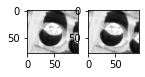

In [95]:
normalized_shadow_enhance = np.round(f.shadow_enhance[0] *(255.0/f.shadow_enhance[0].max()))
f.shadow_enhance[0]
fig, axes = plt.subplots(1,2, figsize=(2,1))

axes[0].imshow(f.shadow_enhance[0])
axes[1].imshow(normalized_shadow_enhance)

In [26]:
(T_simple, threshInv_simple) = cv2.threshold(f.n, 230, 255,cv2.THRESH_BINARY_INV)
(T_otsu, threshInv_otsu) = cv2.threshold(f.n, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
thresh = cv2.adaptiveThreshold(f.n, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 21, 10)
thresh

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [  0, 255,   0, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0],
       [  0,   0, 255, ..., 255,   0,   0]], dtype=uint8)

In [45]:
# global thresholding
ret1,th1 = cv2.threshold(f.tank_crop,127,255,cv2.THRESH_BINARY)
# Otsu's thresholding
ret2,th2 = cv2.threshold(f.tank_crop,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
# Otsu's thresholding after Gaussian filtering
blur = cv2.GaussianBlur(f.tank_crop,(5,5),0)
ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
# plot all the images and their histograms
images = [f.tank_crop, 0, th1,
          f.tank_crop, 0, th2,
          blur, 0, th3]
titles = ['Original Noisy Image','Histogram','Global Thresholding (v=127)',
          'Original Noisy Image','Histogram',"Otsu's Thresholding",
          'Gaussian filtered Image','Histogram',"Otsu's Thresholding"]
for i in range(3):
    plt.subplot(3,3,i*3+1),plt.imshow(images[i*3],'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+2),plt.hist(images[i*3].ravel(),256)
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+3),plt.imshow(images[i*3+2],'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
plt.show()

error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\thresh.cpp:1555: error: (-2:Unspecified error) in function 'double __cdecl cv::threshold(const class cv::_InputArray &,const class cv::_OutputArray &,double,double,int)'
> THRESH_OTSU mode:
>     'src_type == CV_8UC1 || src_type == CV_16UC1'
> where
>     'src_type' is 24 (CV_8UC4)


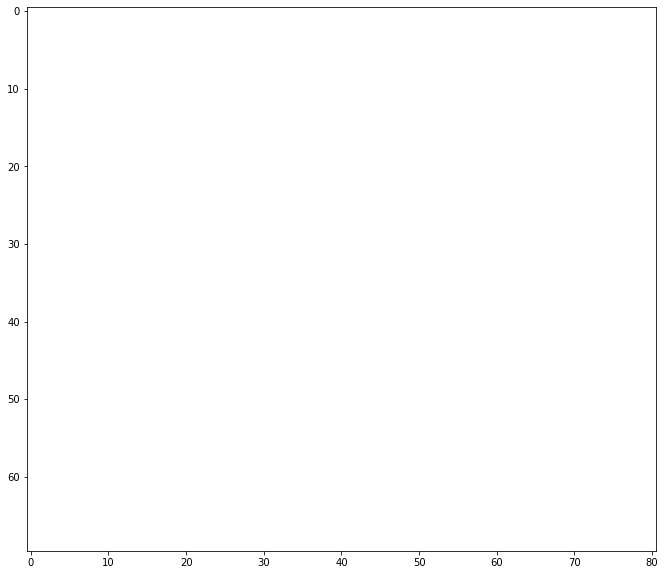

In [41]:
fig, axes = plt.subplots(1,1, figsize=(16,10))
axes.imshow(threshInv)


In [18]:
# Threshold values
t1 = filters.threshold_minimum(f.c4)
t2 = filters.threshold_mean(f.c4)

# Thresholding
tank_thresh = f.c4 > (0.6*t1 + 0.4*t2)
# Processed, labeled image
label_image = measure.label(morphology.area_closing(morphology.closing(
              segmentation.clear_border(filters.hessian(tank_thresh)) )))

# apply threshold
thresh = filters.threshold_otsu(f.c4)
bw = morphology.area_closing(f.c4 > thresh, 3*np.pi*(diameter/2), connectivity=1) 
#area_threshold unsigned int The size parameter (number of pixels). The default value is arbitrarily chosen to be 64. connectivityunsigned int, optional
#The neighborhood connectivity. The integer represents the maximum number of orthogonal steps to reach a neighbor. In 2D, it is 1 for a 4-neighborhood and 2 for a 8-neighborhood. Default value is 1.

# remove artifacts connected to image border
cleared = segmentation.clear_border(bw)

# label image regions
label_image = measure.label(cleared)

# to make the background transparent, pass the value of `bg_label`,
# and leave `bg_color` as `None` and `kind` as `overlay`
image_label_overlay = color.label2rgb(label_image, image=f.tank_crop[:,:,0:3], bg_label=0)

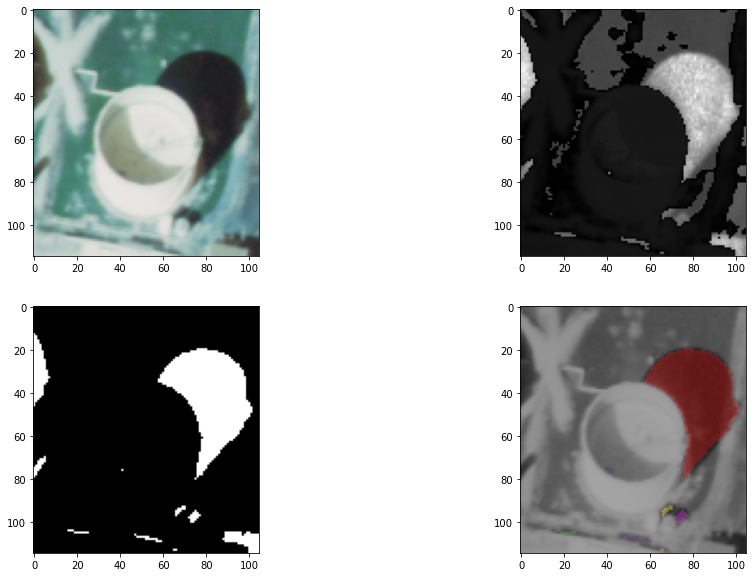

In [19]:
fig, axes = plt.subplots(2, 2, figsize=(16,10))
axes[0,0].imshow(f.tank_crop[:,:,0:3])
axes[0,1].imshow(f.c4)
axes[1,0].imshow(bw)
axes[1,1].imshow(image_label_overlay)
#axes[1].imshow(image_label_overlay)

Test on image `16_3_3.jpg`

Image contains 6 tanks

After processing, we can plot the tank volumes and their volume estimates

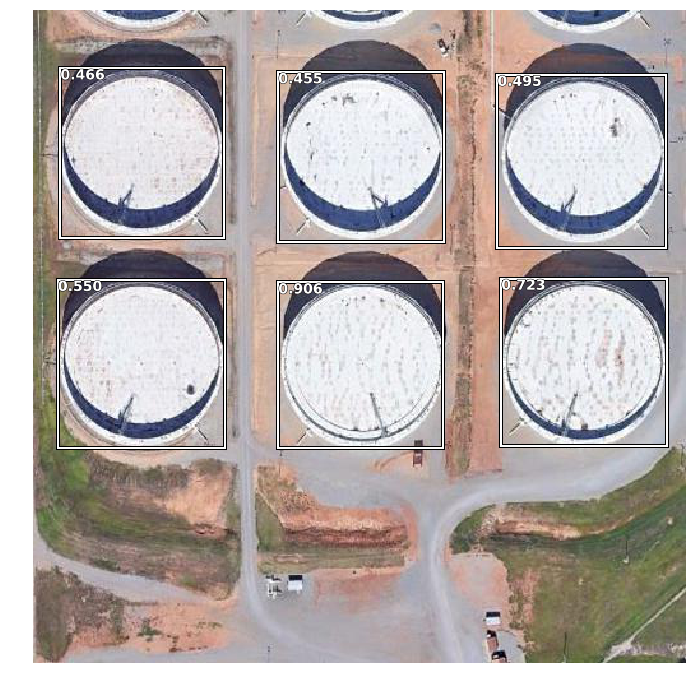

In [16]:
tank.plot_volumes(figsize=(12,12));

These are the contours of the extracted shadows

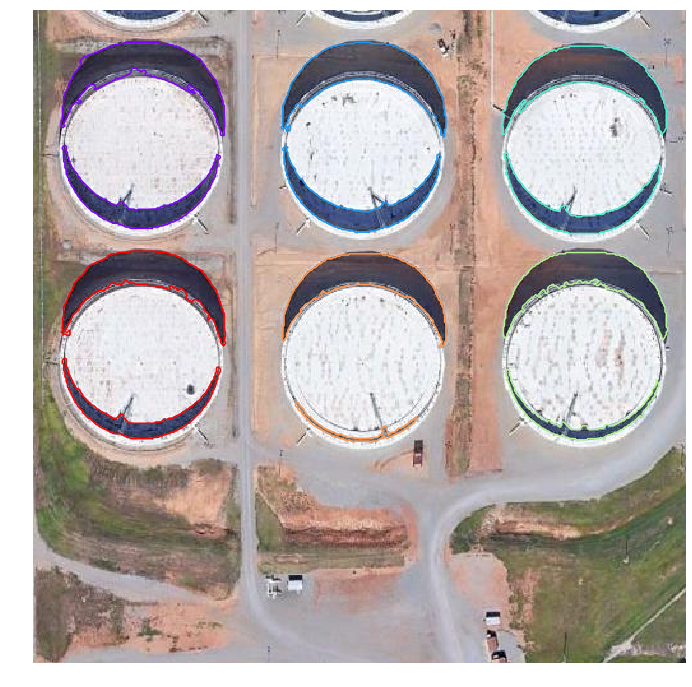

In [17]:
tank.plot_contours()

# How it Works

To see how the algorithm processes a tank, take a single tank in the previous image as an example

In [18]:
single_tank = tank.tanks[1]

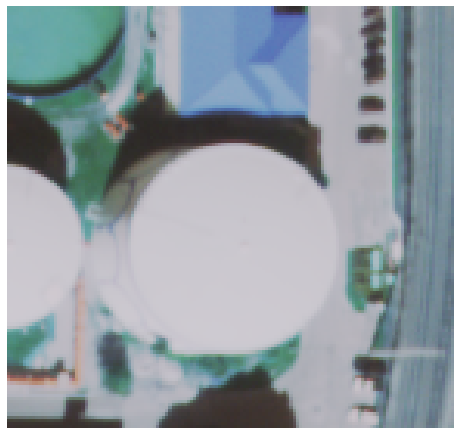

In [19]:
fig, axes = plt.subplots(figsize=(8,8))
axes.imshow(f.tank_crop[:,:,0:3])
axes.axis('off');

We first create two versions of the image - one in HSV color space and one in LAB color space

In [15]:
hsv = color.rgb2hsv(f.tank_crop[:,:,0:3])
H = hsv[:,:,0]
S = hsv[:,:,1]
V = hsv[:,:,2]

lab = color.rgb2lab(f.tank_crop[:,:,0:3])
l1 = lab[:,:,0]
l2 = lab[:,:,1]
l3 = lab[:,:,2]

These are the channels from the converted images. Note which channels show a strong contrast between shadow regions and non-shadow regions 

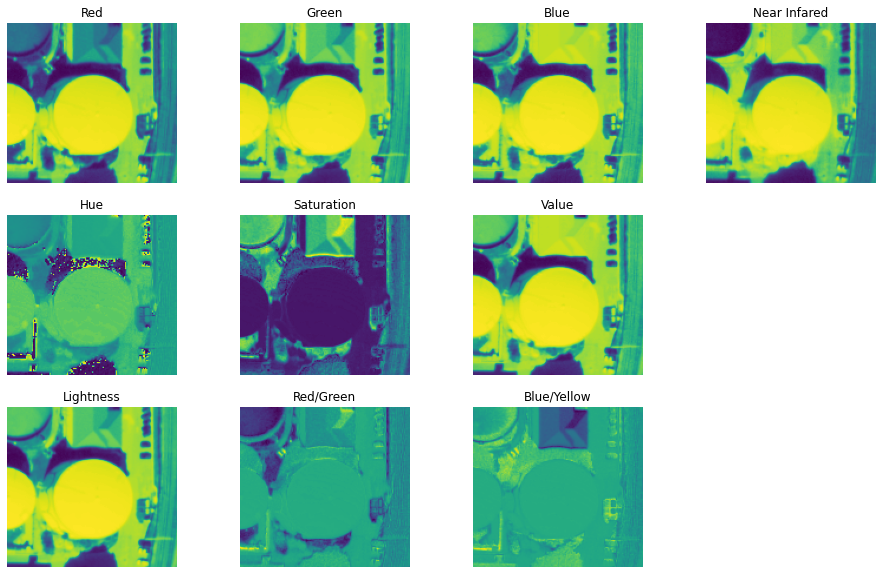

In [48]:
fig, axes = plt.subplots(3, 4, figsize=(16,10))

axes[0][0].imshow(f.tank_crop[:,:,0], cmap = "Reds")
axes[0][0].set_title('Red')

axes[0][1].imshow(f.tank_crop[:,:,1], cmap = "Greens")
axes[0][1].set_title('Green')

axes[0][2].imshow(f.tank_crop[:,:,2], cmap = "Blues")
axes[0][2].set_title('Blue')

axes[0][3].imshow(f.tank_crop[:,:,3], cmap = "Greys")
axes[0][3].set_title('Near Infared')

axes[1][0].imshow(H, cmap='viridis')
axes[1][0].set_title('Hue')

axes[1][1].imshow(S, cmap='viridis')
axes[1][1].set_title('Saturation')

axes[1][2].imshow(V, cmap='viridis')
axes[1][2].set_title('Value')

axes[2][0].imshow(l1, cmap='viridis')
axes[2][0].set_title('Lightness')

axes[2][1].imshow(l2, cmap='viridis')
axes[2][1].set_title('Red/Green')

axes[2][2].imshow(l3, cmap='viridis')
axes[2][2].set_title('Blue/Yellow');

for ax in axes.flat:
    ax.axis('off')

Many methods have been proposed for ratioing these channels to enhance shadows. The NSVDI algorithm proposes $\frac{S-V}{S+V}$. The paper [Estimating the Volume of Oil Tanks Based on High-Resolution Remote Sensing](https://www.mdpi.com/2072-4292/11/7/793/pdf) which explicitly deals with oil tanks suggests $\frac{H+1}{V+1}$.

I found the $\frac{H+1}{V+1}$ was thrown off by strong artifacts in the H channel, likely due to the source images being RGB jpeg images saved from Google Earth rather than real high resolution satellite photography. The $\frac{S-V}{S+V}$ method worked well on some images but failed on others.

Experimentally I found the ratio $\frac{-(l1 + l3)}{V + 1}$ worked well, where $l1$ and $l3$ are the first and third channels of the LAB color space image.


Many methods have been proposed for ratioing these channels to enhance shadows. The NSVDI algorithm proposes $\frac{S-V}{S+V}$. The paper [Estimating the Volume of Oil Tanks Based on High-Resolution Remote Sensing](https://www.mdpi.com/2072-4292/11/7/793/pdf) which explicitly deals with oil tanks suggests $\frac{H+1}{V+1}$.

I found the $\frac{H+1}{V+1}$ was thrown off by strong artifacts in the H channel, likely due to the source images being RGB jpeg images saved from Google Earth rather than real high resolution satellite photography. The $\frac{S-V}{S+V}$ method worked well on some images but failed on others.

Experimentally I found the ratio $\frac{-(l1 + l3)}{V + 1}$ worked well, where $l1$ and $l3$ are the first and third channels of the LAB color space image.

c1 = (H+1)/(V+1)
c2 = (S-V)/(S+V)
c3 = -(l1+l3)/(V+1)

In [49]:
f.wang_transform.min()

0.005128205128205128

In [90]:
c1 = (H+1)/(V+1)
c2 = (S-V)/(S+V)
c3 = -(l1+l3)/(V+1)

fig, axes = plt.subplots(2, 3, figsize=(16,6))
cmap='viridis'
from mpl_toolkits.axes_grid1 import make_axes_locatable


norm = mpl.colors.Normalize(vmin=f.wang_transform.min(), vmax=f.wang_transform.max())
axes[0,0].imshow(1/f.wang_transform, cmap=cmap,norm=norm)
axes[0,0].set_title('(H + 1)/(V + 1)')
divider = make_axes_locatable(axes[0,0])
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=cax, orientation='vertical')#use the defined variables cmap and norm

norm = mpl.colors.Normalize(vmin=f.nsvdi.min(), vmax=f.nsvdi.max())
axes[0,1].imshow(f.nsvdi, cmap=cmap,norm=norm)
axes[0,1].set_title('(S - V)/(S + V)')
divider = make_axes_locatable(axes[0,1])
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=cax, orientation='vertical')#use the defined variables cmap and norm

norm = mpl.colors.Normalize(vmin=f.heyer_transform.min(), vmax=f.heyer_transform.max())
axes[0,2].imshow(f.heyer_transform, cmap=cmap,norm=norm)
axes[0,2].set_title('-(l1 + l3)/(V + 1)')
divider = make_axes_locatable(axes[0,2])
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=cax, orientation='vertical')#use the defined variables cmap and norm

norm = mpl.colors.Normalize(vmin=f.ndwi.min(), vmax=f.ndwi.max())
axes[1,0].imshow(f.ndwi,cmap=cmap,norm=norm)
axes[1,0].set_title('(g - n)/(g + n + 1)')
divider = make_axes_locatable(axes[1,0])
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=cax, orientation='vertical')#use the defined variables cmap and norm

norm = mpl.colors.Normalize(vmin=f.robinson.min(), vmax=f.robinson.max())
axes[1,1].imshow(f.robinson,cmap=cmap,norm=norm)
axes[1,1].set_title('((g - n) + (b - n))/(g + b + n + 1)')
divider = make_axes_locatable(axes[1,1])
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=cax, orientation='vertical')#use the defined variables cmap and norm

norm = mpl.colors.Normalize(vmin=f.robinson.min(), vmax=f.robinson.max())
axes[1,2].imshow(f.robinson,cmap=cmap,norm=norm)
axes[1,2].set_title('((g - n) + (b - n))/(g + b + n + 1)')
divider = make_axes_locatable(axes[1,2])
cax = divider.append_axes('right', size='5%', pad=0.05)
cb = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),cax=cax, orientation='vertical')#use the defined variables cmap and norm

for ax in axes.flat:
    ax.axis('off')

ValueError: operands could not be broadcast together with shapes (136,144) (99,108) 

The enhanced image is filtered by thresholding. I found the minimum threshold was often too stringent, while the mean threshold was too permissive. a combination of `0.6 * minimum_threshold + 0.4 * mean_threshold` works well

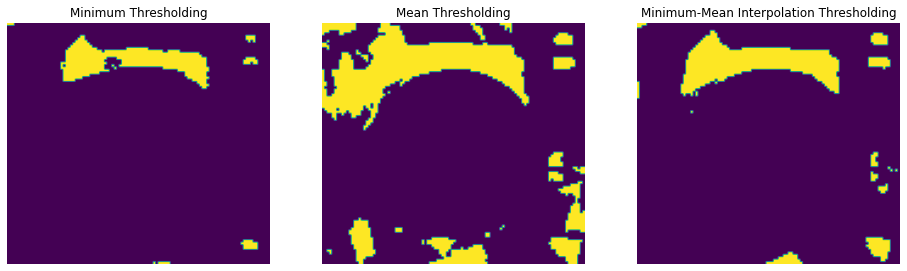

In [106]:
fig, axes = plt.subplots(1, 3, figsize=(16,6))
axes[0].imshow(f.c4 > t1, cmap='viridis')
axes[0].set_title('Minimum Thresholding')
axes[1].imshow(f.c4 > t2, cmap='viridis')
axes[1].set_title('Mean Thresholding')
axes[2].imshow(f.c4 > (0.6*t1 + 0.4*t2), cmap='viridis')
axes[2].set_title('Minimum-Mean Interpolation Thresholding')

for ax in axes.flat:
    ax.axis('off')

The thresholded image is then processed with morphological operations. These operations are:

* 1. Hessian Filter - cleans up noise and line artifacts from white pipes which appear in many images
* 2. Clear Border - clears contours from surrounding tanks
* 3. Morphological Closing - helps separate shapes
* 4. Area Closing - fills small holes
* 5. Morphological Labeling - labels features

In [107]:
tank_thresh = f.c4 > (0.6*t1 + 0.4*t2)

label_1 = filters.hessian(tank_thresh)
label_2 = segmentation.clear_border(filters.hessian(tank_thresh))
label_3 = morphology.closing(segmentation.clear_border(filters.hessian(tank_thresh)))
label_4 = morphology.area_closing(morphology.closing(segmentation.clear_border(filters.hessian(tank_thresh))))
label_image = measure.label(morphology.area_closing(morphology.closing(
            segmentation.clear_border(filters.hessian(tank_thresh)))))

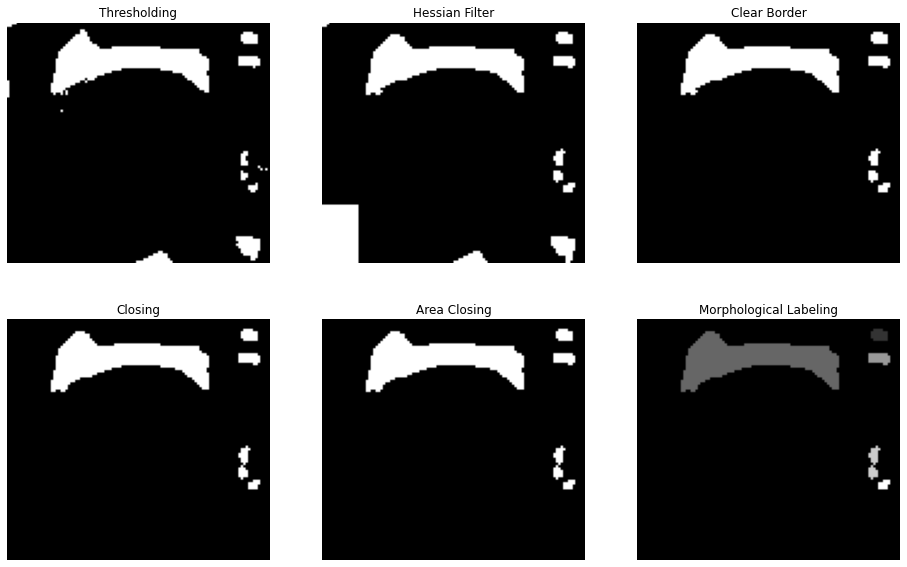

In [108]:
fig, axes = plt.subplots(2, 3, figsize=(16,10))

axes[0][0].imshow(tank_thresh)
axes[0][0].set_title('Thresholding')
axes[0][1].imshow(label_1)
axes[0][1].set_title('Hessian Filter')
axes[0][2].imshow(label_2)
axes[0][2].set_title('Clear Border')
axes[1][0].imshow(label_3)
axes[1][0].set_title('Closing')
axes[1][1].imshow(label_4)
axes[1][1].set_title('Area Closing')
axes[1][2].imshow(label_image)
axes[1][2].set_title('Morphological Labeling')

for ax in axes.flat:
    ax.axis('off')

We then filter the regions present by certain heuristics. The bounding box of the feature should intersect the bounding box of the tank. The feature should have an area of more than 25 pixels. The pixel coverate of the labeled image should be approximately the same as in the threshold image.

The first two clear up small artifacts. The third deals with the fact that the Hessian filter sometimes creates regions in spaces that are otherwise empty.

In [110]:
regions_all = measure.regionprops(label_image)
regions = []

for region in regions_all:
    if vol_est.intersection(single_tank.bbox_relative, region.bbox) > 300:
        if region.area > 25:
            b = region.bbox
            if abs(tank_thresh[b[0]:b[2], b[1]:b[3]].mean() - region.image.mean()) < 0.06:
                regions.append(region)

NameError: name 'single_tank' is not defined

We extract the two tank shadow contours

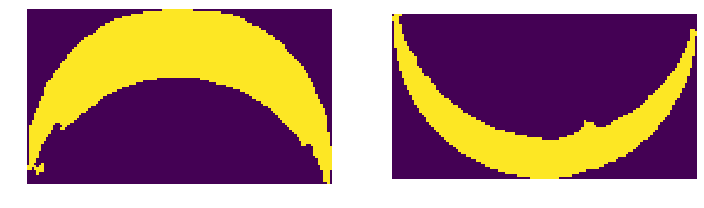

In [29]:
fig, axes = plt.subplots(1, 2, figsize=(12, 8))
axes[0].imshow(regions[0].image)
axes[1].imshow(regions[1].image)
for ax in axes.flat:
    ax.axis('off')

Volume is estimated as 1 minus the ratio of the smaller area to the larger area. The larger area corresponds to the exterior shadow of the tank, while the smaller area corresponds to the interior shadow.

In [30]:
areas = np.array([i.area for i in regions])
idx2, idx1 = areas.argsort()[-2:]
volume = 1 - regions[idx2].area / regions[idx1].area
print(volume)

0.45527584359935724


We create a clean mask by putting just the selected contours on a blank image

In [31]:
blank = np.zeros(single_tank.tank_crop.shape[:2])
for r in regions:
    y_min, x_min, y_max, x_max = r.bbox
    blank[y_min:y_max, x_min:x_max] += r.image.astype('uint8')

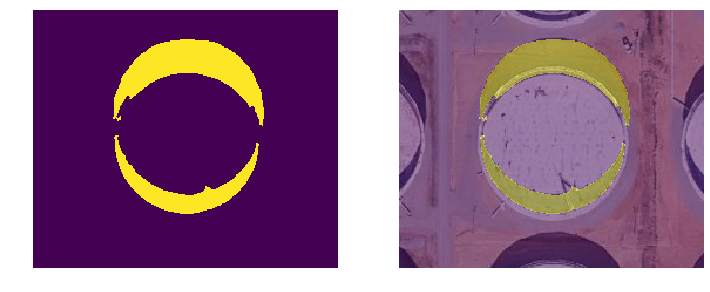

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(12,6))
axes[0].imshow(blank)
axes[1].imshow(single_tank.tank_crop)
axes[1].imshow(blank, alpha=0.5)
for ax in axes.flat:
    ax.axis('off')

We extract the contours from the mask

In [33]:
contours = measure.find_contours(blank, 0.5)

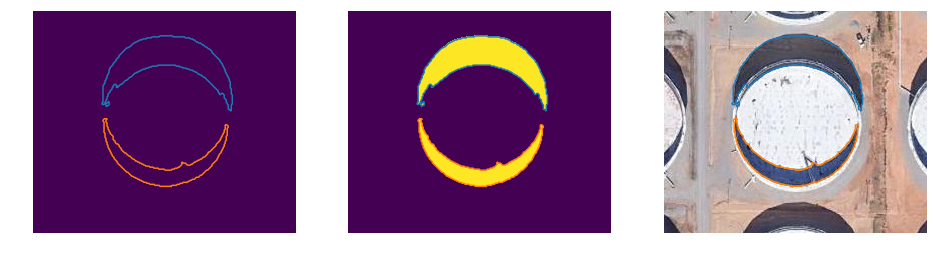

In [34]:
fig, axes = plt.subplots(1, 3, figsize=(16,10))
axes[0].imshow(np.zeros(blank.shape))
axes[1].imshow(blank)
axes[2].imshow(single_tank.tank_crop)

for ax in axes:
    for c in contours:
        ax.plot(c[:,1], c[:,0])
        
for ax in axes.flat:
    ax.axis('off')

# Large Image Processing

Since images in the dataset are patches, we can stitch the patches back together and process larger regions. The only trick is to scale the bounding boxes for patches correctly.

In [35]:
def get_idxs(start, rows, cols):
    idxs = []
    for r in range(rows):
        row = []
        for c in range(cols):
            row.append(start + c + 10*r)
        idxs.append(row)
        
    return idxs

In [36]:
idxs = get_idxs(1450, 5, 5)

In [37]:
idxs

[[1450, 1451, 1452, 1453, 1454],
 [1460, 1461, 1462, 1463, 1464],
 [1470, 1471, 1472, 1473, 1474],
 [1480, 1481, 1482, 1483, 1484],
 [1490, 1491, 1492, 1493, 1494]]

In [38]:
def generate_composite(idxs):
    file = open(path/'labels.json')
    j = json.load(file)

    rows = len(idxs)
    cols = len(idxs[0])
    patch_height, patch_width = (512, 512)
    overlap_height, overlap_width = (37, 37)

    image_height = rows*patch_height - overlap_height * (rows-1)
    image_width = cols*patch_width - overlap_width * (cols-1)

    step_width = patch_width - overlap_width
    step_height = patch_height - overlap_height

    im_mask = torch.zeros((3, image_height, image_width))
    bboxes = []

    for i, row in enumerate(idxs):
        for k, idx in enumerate(row):
            fname = j[idx]['file_name']
            im = open_image(path/f'image_patches/{fname}')

            im_mask[:, (i*step_height):(i*step_height)+patch_height, (k*step_width):(k*step_width)+patch_width] = im.data

            try:
                bbox = j[idx]['label']['Floating Head Tank']
                bbox = [i for i in bbox] # if check_bb(i['geometry'], im.shape)]
                bbox_scaled = [i for i in bbox]
                for box in bbox_scaled:
                    for point in box['geometry']:
                        point['x'] += step_width * k
                        point['y'] += step_height * i

                bbox_scaled = [i for i in bbox_scaled if check_bb(i['geometry'], im_mask.shape)]

                bbox_clean = []
                for box in bbox_scaled:
                    y_min, x_min, y_max, x_max = conv_bbox(box['geometry'])
                    if not (x_max-x_min) <=40 or (y_max-y_min) <=40:
                        bbox_clean.append(box)

                bboxes += bbox_clean
            except:
                pass
    
    return (im_mask, bboxes)

In [39]:
im_mask, bboxes = generate_composite(idxs)

A composite image

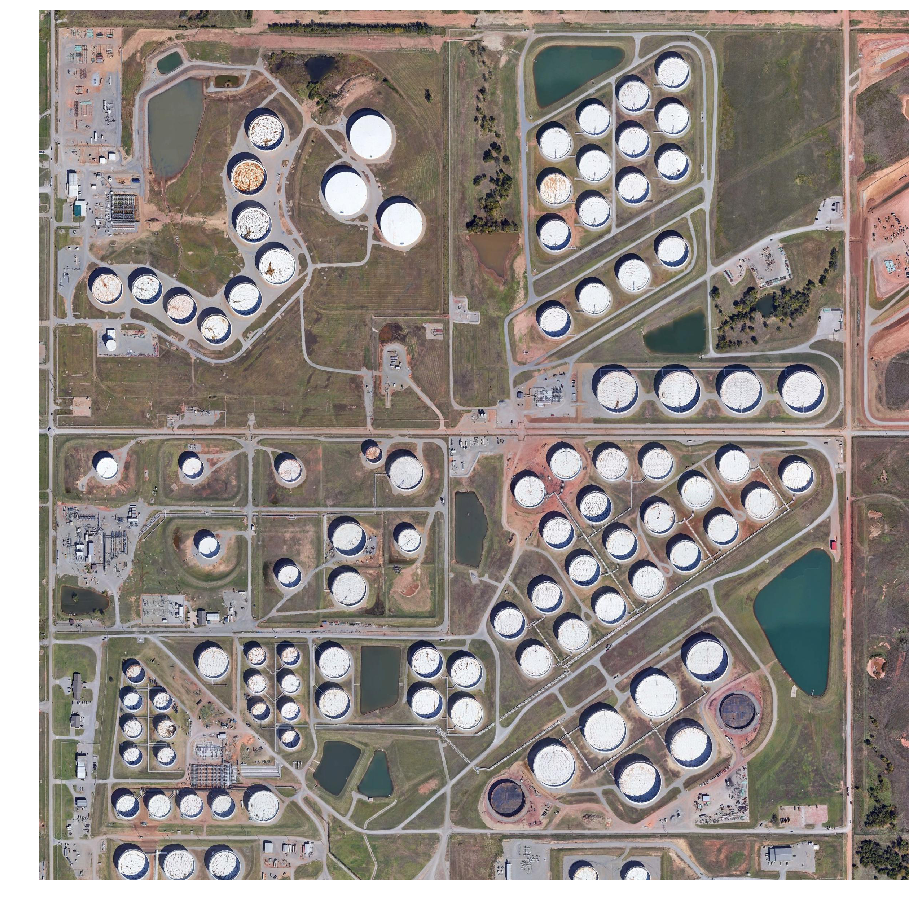

In [40]:
fig, axes = plt.subplots(figsize=(16,16))
axes.imshow(im_mask.permute(1,2,0))
axes.axis('off');

In [41]:
coords = [conv_bbox(i['geometry']) for i in bboxes]

In [42]:
composite_image = Image(im_mask)

In [43]:
box_vol = ImageBBox.create(*composite_image.size, coords)

Bounding boxes for the composite image. You can see regions where patches overlap and tanks get multiple bounding boxes. I'm still working on a way of dealing with this. It's not as straightforward as merging overlapping bounding boxes - some closely packed tanks have natural bounding box overlap.

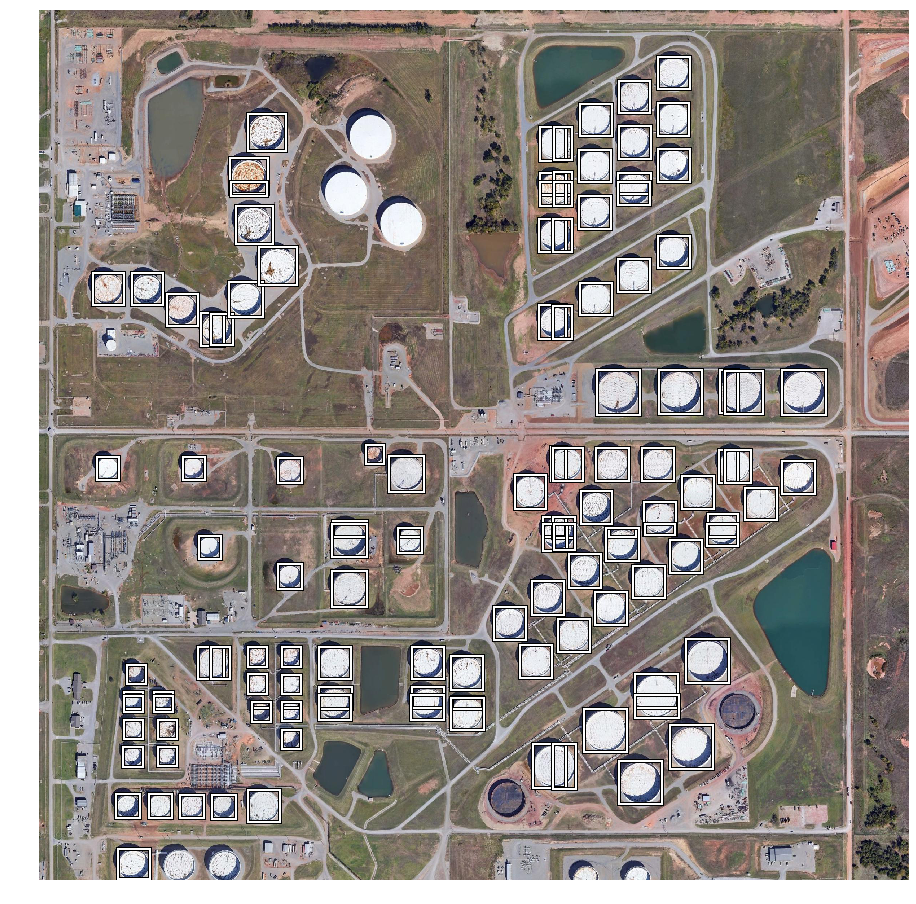

In [44]:
composite_image.show(figsize=(16,16), y=box_vol)

In [45]:
tank_large = MultiTank(bboxes, composite_image)

Contours for the localized tanks

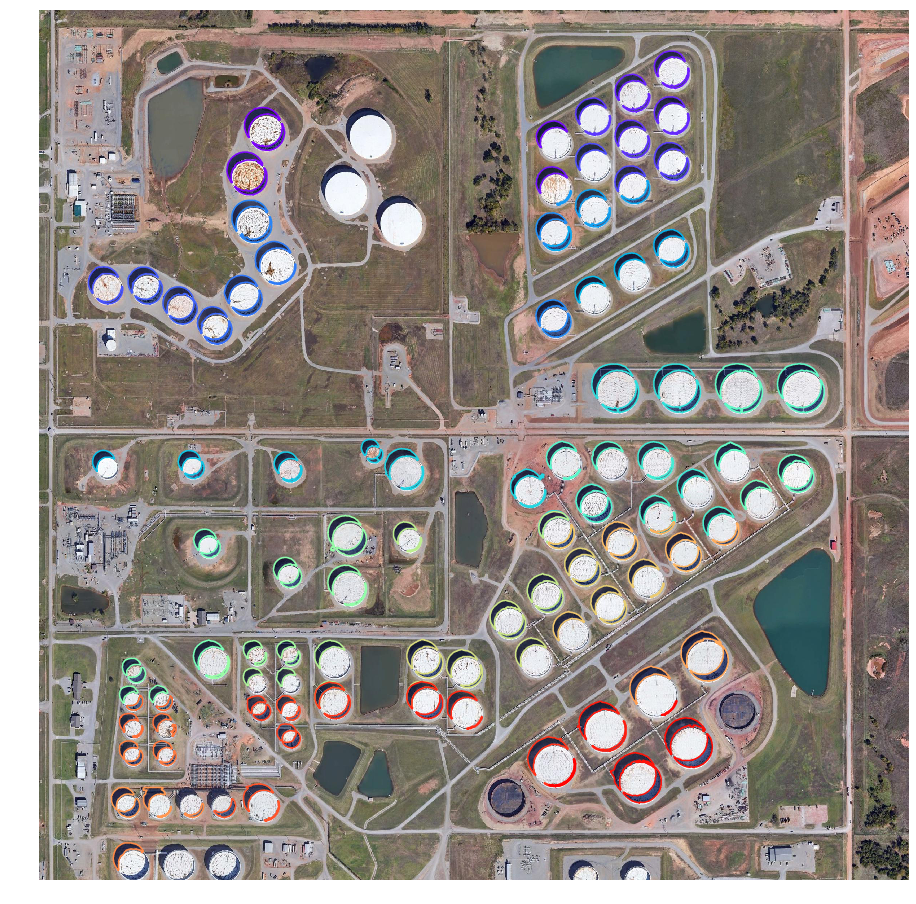

In [46]:
tank_large.plot_contours(figsize=(16,16))

Contour mask

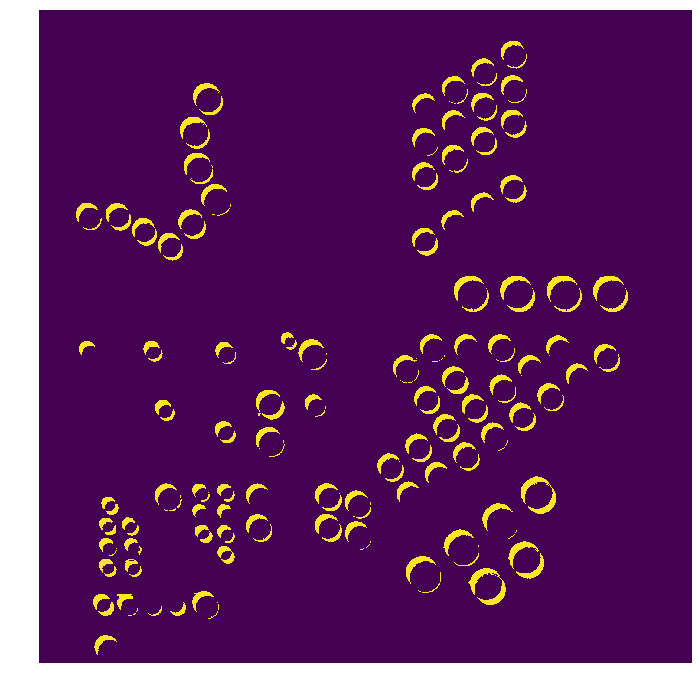

In [47]:
fig, axes = plt.subplots(figsize=(12,12))
axes.imshow(tank_large.mask_binary)
axes.axis('off');

Volume estimations

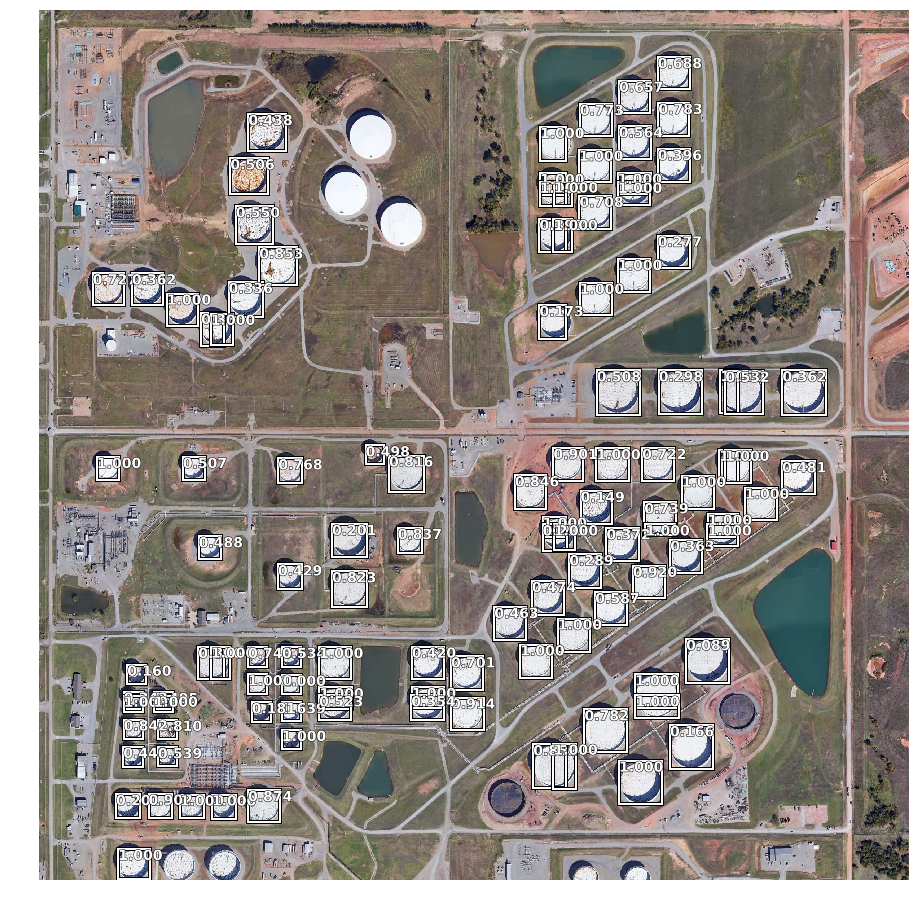

In [48]:
tank_large.plot_volumes(figsize=(16,16))

Another image

In [49]:
idxs = get_idxs(4333, 5, 5)

In [50]:
im_mask, bboxes = generate_composite(idxs)

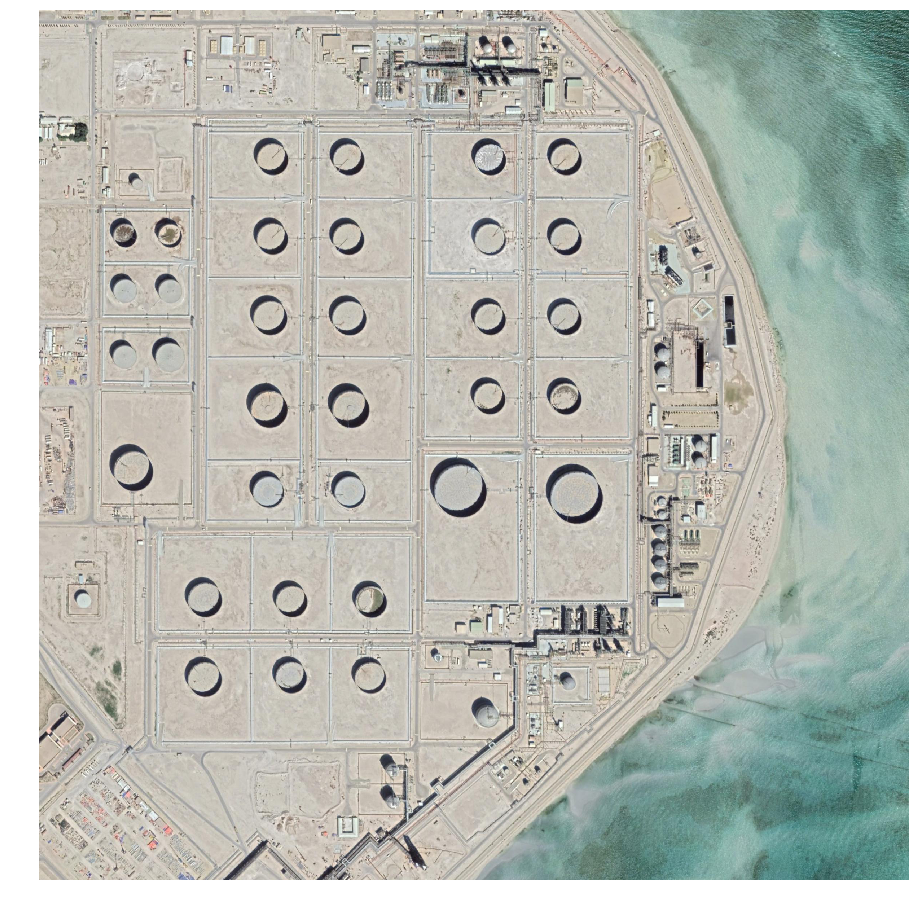

In [51]:
fig, axes = plt.subplots(figsize=(16,16))
axes.imshow(im_mask.permute(1,2,0))
axes.axis('off');

In [52]:
coords = [conv_bbox(i['geometry']) for i in bboxes]
composite_image = Image(im_mask)
box_vol = ImageBBox.create(*composite_image.size, coords)

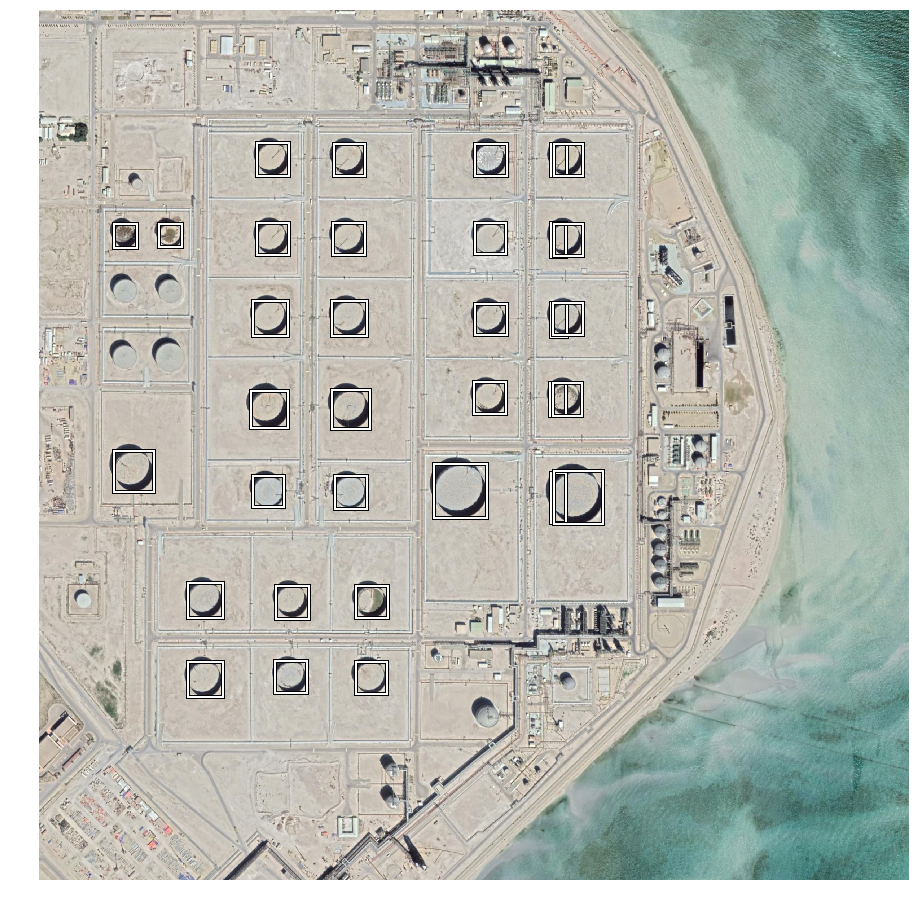

In [53]:
composite_image.show(figsize=(16,16), y=box_vol)

In [54]:
tank_large = MultiTank(bboxes, composite_image)

Contours for the localized tanks

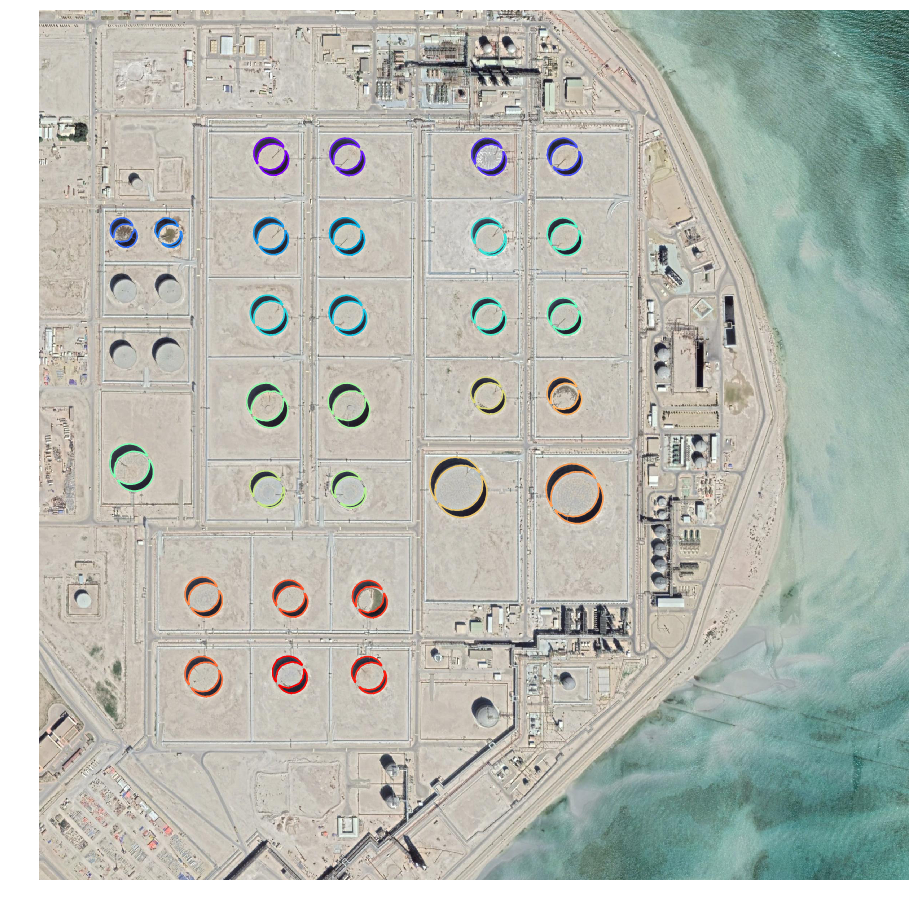

In [55]:
tank_large.plot_contours(figsize=(16,16))

Contour mask

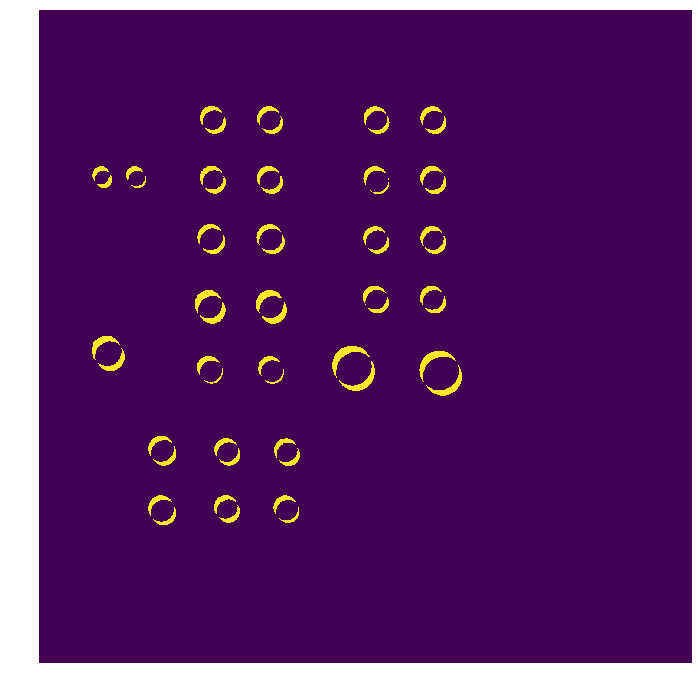

In [56]:
fig, axes = plt.subplots(figsize=(12,12))
axes.imshow(tank_large.mask_binary)
axes.axis('off');

Volume estimations

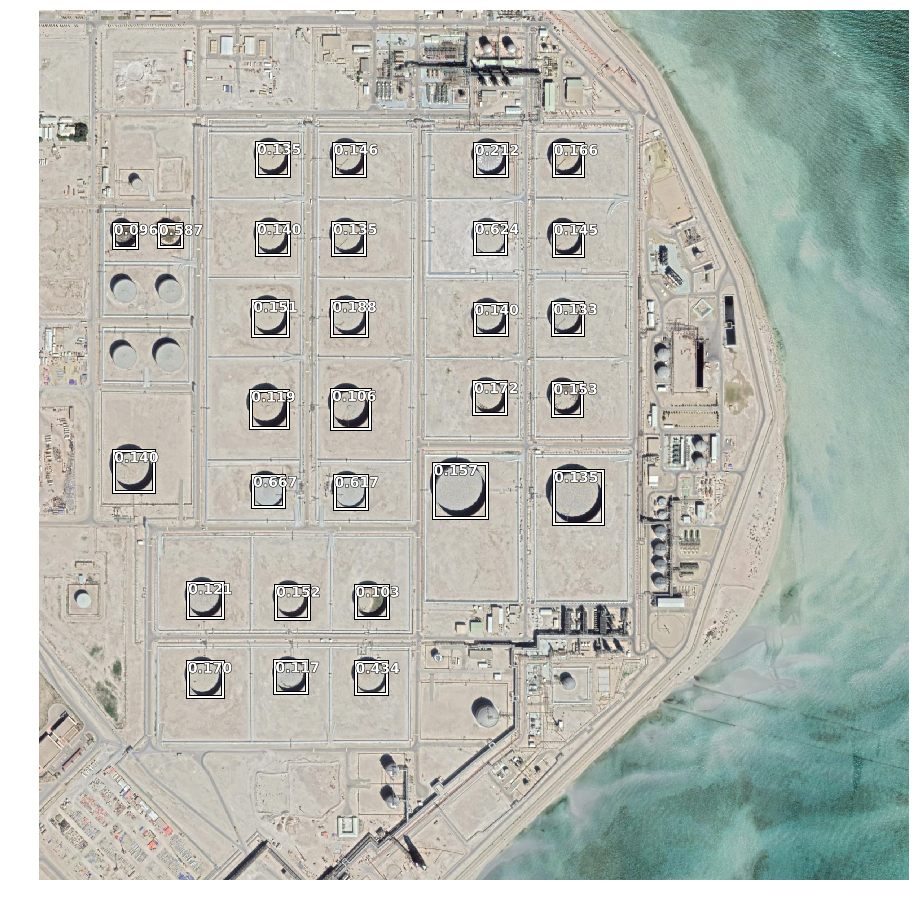

In [57]:
tank_large.plot_volumes(figsize=(16,16))

In [58]:
idxs = get_idxs(1833, 5, 5)

In [59]:
im_mask, bboxes = generate_composite(idxs)

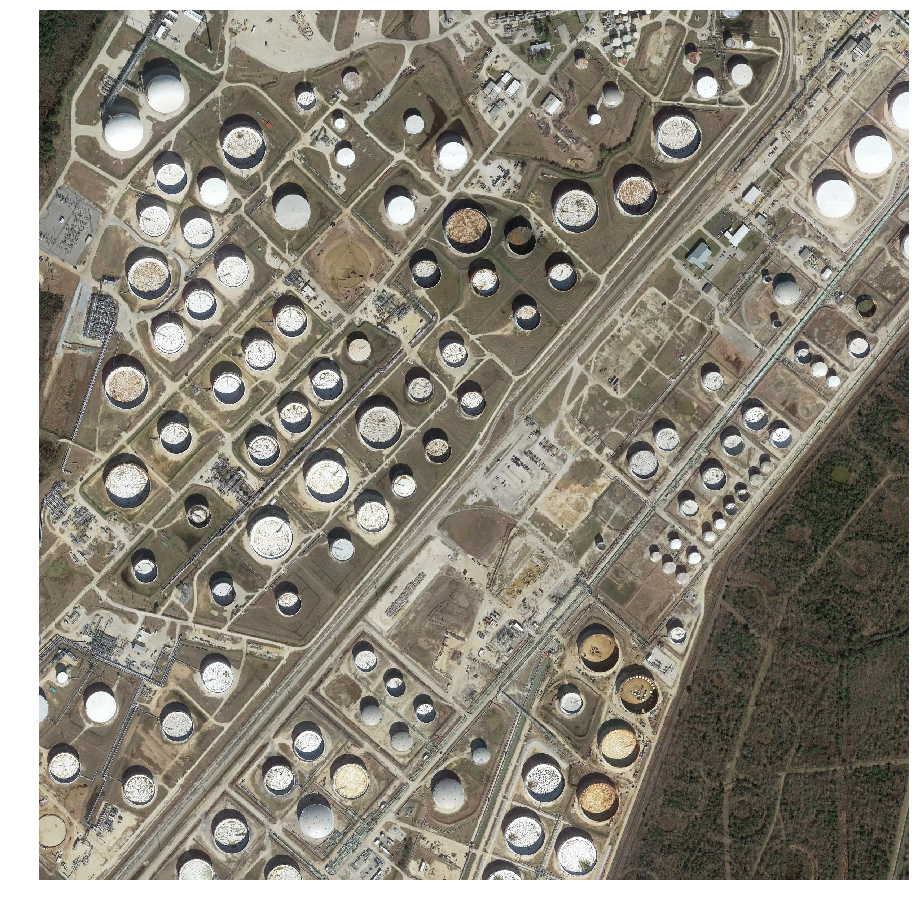

In [60]:
fig, axes = plt.subplots(figsize=(16,16))
axes.imshow(im_mask.permute(1,2,0))
axes.axis('off');

In [61]:
coords = [conv_bbox(i['geometry']) for i in bboxes]
composite_image = Image(im_mask)
box_vol = ImageBBox.create(*composite_image.size, coords)

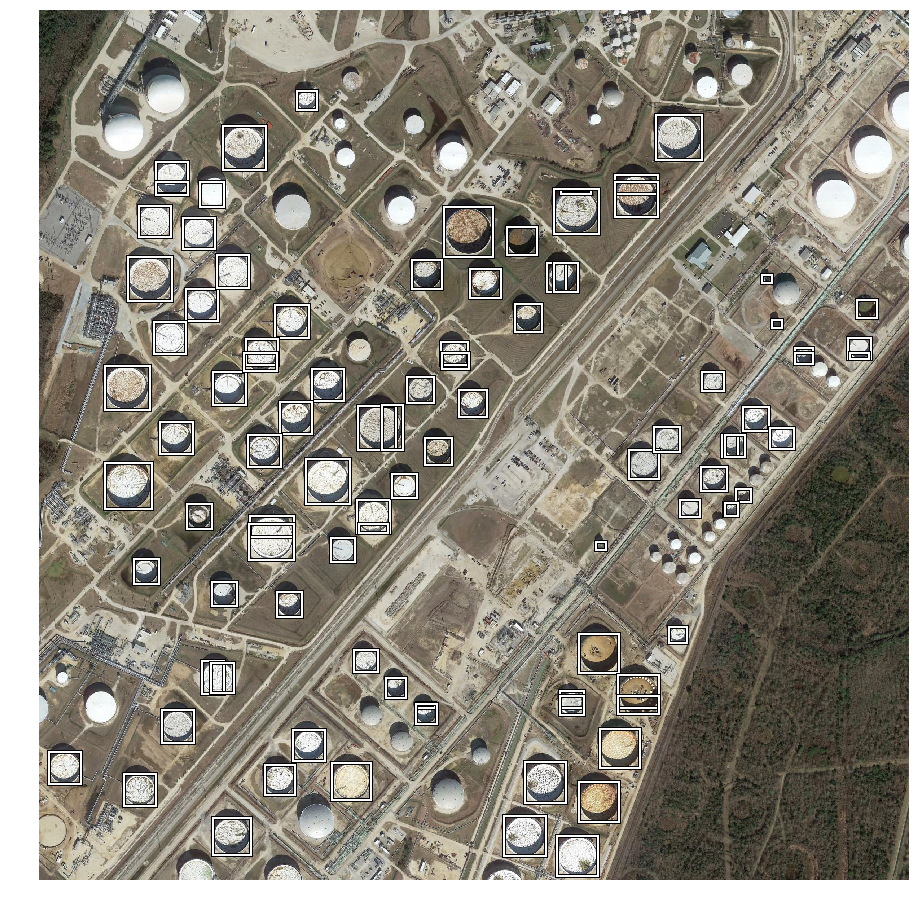

In [62]:
composite_image.show(figsize=(16,16), y=box_vol)

In [63]:
tank_large = MultiTank(bboxes, composite_image)

Contours for the localized tanks

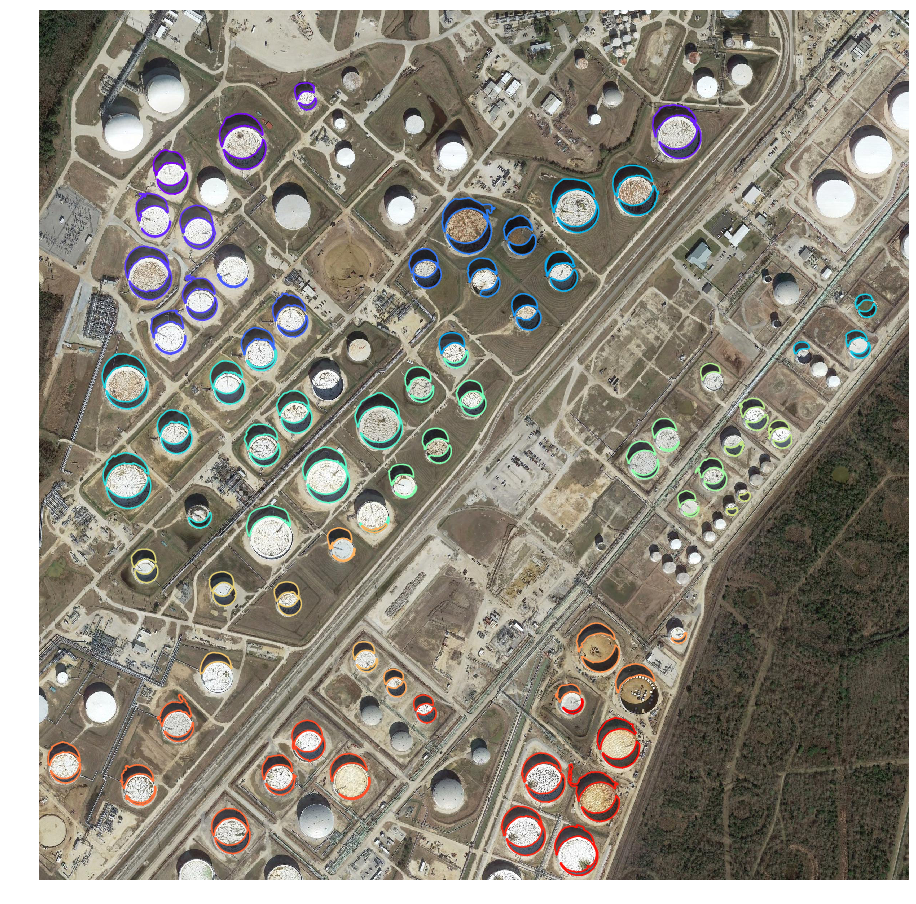

In [64]:
tank_large.plot_contours(figsize=(16,16))

Contour mask

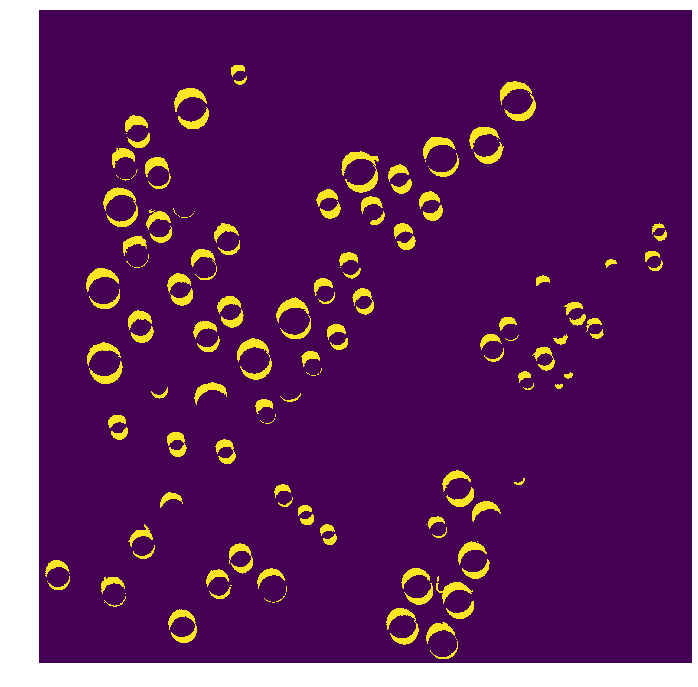

In [65]:
fig, axes = plt.subplots(figsize=(12,12))
axes.imshow(tank_large.mask_binary)
axes.axis('off');

Volume estimations

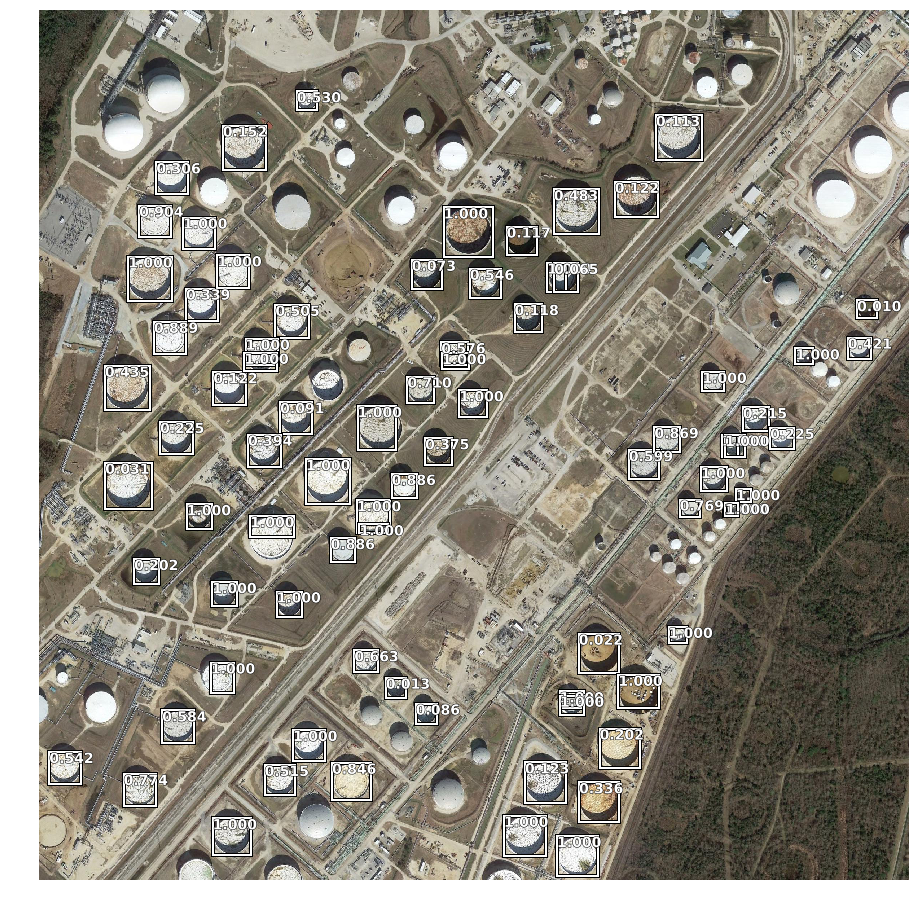

In [66]:
tank_large.plot_volumes(figsize=(16,16))